In [1]:
# Data handling modules
import pandas as pd
import numpy as np
import geopandas as gpd 

# Statistic modules
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Cluster modules
from sklearn.metrics import silhouette_samples, silhouette_score, calinski_harabasz_score
from sklearn.cluster import KMeans, BisectingKMeans

# Plotting and mapping modules
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import cartopy.crs as ccrs

# Custom functions for array to raster and raster to vector operations
from process_functions import *

In [2]:
df=pd.read_csv('C:/Users/sarahann.USERS/Desktop/scripts_jp/agroecology_paper/data_processing/final_processing/final_post_patrignani_adjustments/variables.csv',index_col=0)

In [196]:
# CV 
(df.std()/df.mean())*100

paws_050      16.721584
om_kg_sq_m    31.835723
pet           10.695086
precip        27.115648
temp           7.499791
depth_adj     40.583938
dtype: float64

In [43]:
df.describe()

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj
count,316210.000000,316207.000000,319590.000000,317317.000000,317317.000000,316521.000000
mean,8.714345,20.246174,1282.599201,743.051382,12.641791,95.087750
std,1.457177,6.445516,137.175086,201.483201,0.948108,38.590354
min,1.000000,1.000000,0.000352,428.992030,10.540001,0.011830
25%,8.000000,17.000000,1196.599025,561.004000,11.890000,66.255270
50%,9.000000,20.000000,1277.525950,720.937000,12.730000,81.000000
75%,10.000000,24.000000,1380.154775,911.958070,13.330001,150.000000
max,22.000000,225.000000,1590.157500,1207.073000,14.960001,150.000000


In [44]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 324352 entries, 0 to 324351
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   paws_050    316210 non-null  float64
 1   om_kg_sq_m  316207 non-null  float64
 2   pet         319590 non-null  float64
 3   precip      317317 non-null  float64
 4   temp        317317 non-null  float64
 5   depth_adj   316521 non-null  float64
dtypes: float64(6)
memory usage: 17.3 MB


In [3]:
# Obtain Index for non_null values 
null_idx= df[df.isnull().any(axis=1)].index
non_null_idx = df[~df.isnull().any(axis=1)].index

df.iloc[non_null_idx].head(3)

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj
897,11.0,15.0,1294.4242,461.92102,10.650001,35.645320
898,10.0,12.0,1294.2223,461.59200,10.670000,47.127870
899,8.0,13.0,1293.8615,461.33300,10.700001,59.862305


**Climate Variables**

In [18]:
X = df.loc[non_null_idx] # only use non nan values. The irregular bounds of Kansas have nan values. 

climate_features = X [['precip', 'temp', 'pet']] # Select Variables 

# Normalize the values with scaling
scaler= StandardScaler()
X_climate= scaler.fit_transform(climate_features)

# Transform to PCAs capturing 95% of variability 
print('Climate shape', X_climate.shape)
X_climate=PCA(.95).fit_transform(X_climate)
print('Climate PCA fit shape', X_climate.shape)

Climate shape (316183, 3)
Climate PCA fit shape (316183, 2)


**K-means for Climate Variables**

In [5]:
# Kmeans loop to evaluate performance of various cluster numbers for a macro climate cluster
print ('Performance of Kmeans models with Climate Data')
range_n_clusters = [2, 3, 4, 5]

X = X_climate

for n_clusters in range_n_clusters:
    clusters = KMeans(n_clusters)            
    cluster_labels = clusters.fit_predict(X)
    silhouette_avg = silhouette_score(X, cluster_labels, metric='sqeuclidean')
    CHS_avg = calinski_harabasz_score(X, cluster_labels)
    print("For", n_clusters, "clusters",
          "silhouette score is:", round(silhouette_avg,2),
          "and the calinski harabasz score is:", round(CHS_avg,2))

Performance of Kmeans models with Climate Data
For 2 clusters silhouette score is: 0.58 and the calinski harabasz score is: 256429.99
For 3 clusters silhouette score is: 0.59 and the calinski harabasz score is: 279489.27
For 4 clusters silhouette score is: 0.56 and the calinski harabasz score is: 284198.76
For 5 clusters silhouette score is: 0.53 and the calinski harabasz score is: 275105.43


In [19]:
# Cluster of 3 has the best performance. Predict this cluster number and append to the original data frame
clusters = KMeans(n_clusters=3)            
kmean_3_cluster = clusters.fit_predict(X_climate)

df.loc[non_null_idx,'macro'] = kmean_3_cluster + 1 # 1 is added so that the first cluster is 1 instead of 0 
df.iloc[3000:3005].head(3)

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj,macro
3000,11.0,19.0,1195.7748,633.86304,11.140000,67.77346,1.0
3001,11.0,19.0,1194.7639,633.27000,11.150001,71.14735,1.0
3002,11.0,19.0,1193.6299,632.71000,11.170000,76.02999,1.0


In [20]:
# Get the Stats per each Macro area
# To match macro Organic Matter: 1=19, 2=23, 3= 16
df.groupby(['macro']).mean()

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj
macro,,,,,,
1.0,9.717875,19.127456,1284.479495,584.408860,11.571170,89.759551
2.0,8.244687,23.851658,1193.459917,948.539011,13.077480,90.229361
3.0,8.281164,16.242640,1421.340414,621.432150,13.214385,108.015129


In [22]:
(df.groupby(['macro']).std()/df.groupby(['macro']).mean())*100

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj
macro,,,,,,
1.0,0.098782,0.219792,0.058811,0.168530,0.042127,0.473866
2.0,0.132215,0.267157,0.076067,0.110816,0.052750,0.338690
3.0,0.215589,0.351082,0.043609,0.188682,0.045222,0.382152


In [51]:
df.groupby(['macro']).min()

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj
macro,,,,,,
1.0,3.0,2.0,1072.198000,431.02203,10.540001,0.141541
2.0,4.0,1.0,31.376455,716.36700,11.250001,0.148163
3.0,3.0,1.0,1276.233600,428.99203,11.820001,0.011830


In [23]:
df.groupby(['macro']).max()

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj
macro,,,,,,
1.0,13.0,49.0,1477.4196,885.21800,12.730000,150.0
2.0,18.0,117.0,1351.9801,1207.07300,14.960001,150.0
3.0,12.0,49.0,1590.1575,894.04407,14.930000,150.0


**Soil Variables**

In [24]:
X = df.loc[non_null_idx]
soil_features = X[['paws_050', 'om_kg_sq_m', 'depth_adj']] # Select Variables 

# Normalize the values with scaling
scaler= StandardScaler()
X_soil= scaler.fit_transform(soil_features)

# *Note. Soil data is not transformed into PCAs as 95% captures all features
print('Soil data shape', X_soil.shape)

Soil data shape (316183, 3)


**Nested clustering. For each climate macro cluster, cluster a micro cluster on with soil data**

In [25]:
# Divide the data into the three sets of macro clusters by index 
cluster_numbers = list(np.unique(kmean_3_cluster))

nest = []
for i in cluster_numbers:
    idx = np.where(kmean_3_cluster == i)
    nest_cluster = X_soil[idx]              # this is the soil data
    nest.append(nest_cluster)
    
# Check is the length of the list is equivalent to the number of clusters
len(nest)

3

**K-means for Soil Variables for each Macro Cluster**

In [26]:
print ('Performance of Kmeans micro models with soil data')
range_n_clusters = [ 2, 3, 4, 5]

for i in cluster_numbers:
    print ('')
    x = nest[i]
    for n_clusters in range_n_clusters:
        clusters = KMeans(n_clusters)            
        cluster_labels = clusters.fit_predict(x)
        silhouette_avg_s = silhouette_score(x, cluster_labels, metric='sqeuclidean')
        CHS_avg = calinski_harabasz_score(x, cluster_labels)
        print("For", i, 'macro cluster and', n_clusters, "micro clusters",
              "sqeuclidean silhouette score is:", round(silhouette_avg_s,2), 
              "and the calinski harabasz score is:", round(CHS_avg,2))

Performance of Kmeans micro models with soil data

For 0 macro cluster and 2 micro clusters sqeuclidean silhouette score is: 0.7 and the calinski harabasz score is: 105992.67
For 0 macro cluster and 3 micro clusters sqeuclidean silhouette score is: 0.63 and the calinski harabasz score is: 91716.47
For 0 macro cluster and 4 micro clusters sqeuclidean silhouette score is: 0.62 and the calinski harabasz score is: 83197.4
For 0 macro cluster and 5 micro clusters sqeuclidean silhouette score is: 0.55 and the calinski harabasz score is: 79128.68

For 1 macro cluster and 2 micro clusters sqeuclidean silhouette score is: 0.47 and the calinski harabasz score is: 71272.07
For 1 macro cluster and 3 micro clusters sqeuclidean silhouette score is: 0.46 and the calinski harabasz score is: 64792.38
For 1 macro cluster and 4 micro clusters sqeuclidean silhouette score is: 0.45 and the calinski harabasz score is: 61244.26
For 1 macro cluster and 5 micro clusters sqeuclidean silhouette score is: 0.4 and

In [55]:
# Predict each micro_cluster with each cluster based on performance metrics 
x = nest[0]
cluster_number = 2
clusters = KMeans(cluster_number)            
cluster_1_micro = clusters.fit_predict(x)

x = nest[1]
cluster_number = 2
clusters = KMeans(cluster_number)            
cluster_2_micro = clusters.fit_predict(x)

x = nest[2]
cluster_number = 2
clusters = KMeans(cluster_number)            
cluster_3_micro = clusters.fit_predict(x)

In [56]:
# Add micro cluster column to each macro cluster 
df.loc[df.loc[df['macro'] == 1].index, 'micro'] = cluster_1_micro + 1 # Macro Cluster 1
df.loc[df.loc[df['macro'] == 2].index, 'micro'] = cluster_2_micro + 1 # Macro Cluster 2
df.loc[df.loc[df['macro'] == 3].index, 'micro'] = cluster_3_micro + 1 # Macro Cluster 3

**Export the Clusters to a Raster and Vector Format**

In [57]:
# Add a single column that provides information for macro and micro cluster.
df['cluster'] = (df.macro*10)+ df.micro

In [186]:
df.iloc[non_null_idx].groupby(['cluster']).mean()

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj,macro,micro
cluster,,,,,,,,
11.0,9.608010,18.980255,1261.479294,622.557670,11.681409,63.023810,1.0,1.0
12.0,9.961553,19.449639,1335.590521,499.776055,11.327985,148.891887,1.0,2.0
21.0,8.831776,28.528168,1193.011460,951.702516,13.126105,102.273725,2.0,1.0
22.0,7.669986,19.272390,1193.866377,945.372974,13.029090,78.428370,2.0,2.0
31.0,9.395344,19.405308,1414.473028,614.623661,13.119361,98.544403,3.0,1.0
32.0,6.298698,10.616183,1433.583154,633.675969,13.384732,124.873798,3.0,2.0


In [58]:
# Get the Stats per each micro area
df.groupby(['cluster']).mean()

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj,macro,micro
cluster,,,,,,,,
11.0,9.608010,18.980255,1261.479294,622.557670,11.681409,63.023810,1.0,1.0
12.0,9.961553,19.449639,1335.590521,499.776055,11.327985,148.891887,1.0,2.0
21.0,8.831776,28.528168,1193.011460,951.702516,13.126105,102.273725,2.0,1.0
22.0,7.669986,19.272390,1193.866377,945.372974,13.029090,78.428370,2.0,2.0
31.0,9.395344,19.405308,1414.473028,614.623661,13.119361,98.544403,3.0,1.0
32.0,6.298698,10.616183,1433.583154,633.675969,13.384732,124.873798,3.0,2.0


In [59]:
df.groupby(['cluster']).max()

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj,macro,micro
cluster,,,,,,,,
11.0,13.0,49.0,1463.9725,885.21800,12.730000,117.5548,1.0,1.0
12.0,13.0,48.0,1477.4196,845.67100,12.720000,150.0000,1.0,2.0
21.0,18.0,117.0,1351.9696,1196.14900,14.960001,150.0000,2.0,1.0
22.0,13.0,31.0,1351.9801,1207.07300,14.920001,150.0000,2.0,2.0
31.0,12.0,49.0,1585.7222,895.19104,14.930000,150.0000,3.0,1.0
32.0,9.0,29.0,1590.1575,883.79300,14.930000,150.0000,3.0,2.0


In [193]:
(df.groupby(['cluster']).std()/df.groupby(['cluster']).mean())*100

,paws_050,om_kg_sq_m,pet,precip,temp,depth_adj,macro,micro
cluster,,,,,,,,
11.0,10.784934,21.763852,5.630055,14.448174,4.039491,28.053191,0.0,0.0
12.0,7.082417,22.317673,4.354596,10.648169,3.796712,4.369143,0.0,0.0
21.0,9.385927,17.259984,7.514645,11.445725,4.813631,31.589294,0.0,0.0
22.0,13.110963,19.579185,7.694218,10.702123,5.675434,29.762725,0.0,0.0
31.0,9.242404,20.444325,4.222923,18.479106,4.731085,39.489335,0.0,0.0
32.0,18.633308,33.875688,4.463986,19.351308,3.820768,31.999441,0.0,0.0


In [61]:
df.to_csv('features_clusters.csv')

In [62]:
# Use one map as the template to reshape array. 
# PRISM Elevation is a standard 800m grid product
template = rasterio.open('C:/Users/sarahann.USERS/Desktop/code/ks_agro_climate/elv_wgs84_ks.tif').read(1)
print(template.shape)
new_width = template.shape[1]
new_height = template.shape[0]

(362, 896)


In [63]:
# Conver to array as input to raster file 
cluster = df.cluster.to_numpy() 
#cluster = df
np.nan_to_num(cluster, nan=-9999)
cluster= np.reshape(cluster, template.shape)

In [64]:
# Convert array to raster tif
rasterfn='C:/Users/sarahann.USERS/Desktop/code/ks_agro_climate/elv_wgs84_ks.tif'
file_str = 'C:/Users/sarahann.USERS/Desktop/code/ks_agro_climate/cluster.tif'
array2raster(file_str,rasterfn,cluster)    

In [65]:
# Convert tif to vector shape 
path = 'C:/Users/sarahann.USERS/Desktop/code/ks_agro_climate/cluster.tif'
string = 'cluster'
rast2vec(path, string)

**Visualize the Clusters**

In [31]:
# Load the vector fiel 
shp_path = 'C:/Users/sarahann.USERS/Desktop/code/ks_agro_climate/cluster.shp'
df_map = gpd.read_file(shp_path)

In [32]:
# Divide Clusters for Macro Cluster as whole number and Micro Cluster as decimal 
df_map.cluster = df_map.cluster/10
df_map['cluster'].replace(0, np.NaN, inplace=True) #convert 0 back to nan values

In [33]:
# Shape file of State of Kansas
fp= 'C:/Users/sarahann.USERS/Desktop/code/cb_2018_us_state_500k.shp' # state shape file. 
kansas = gpd.read_file(fp)
ks_map = kansas.NAME.isin(['Kansas']) 
ks_map = kansas[ks_map].loc[0:]
ks_map.to_crs(epsg=4269, inplace=True)

# County shape file, use for county lines
fp= 'C:/Users/sarahann.USERS/Desktop/code/us_county/US_County_Boundaries.shp' # county file

map_county = gpd.read_file(fp)
# Delete Non-contingous US counties 
ks_county = map_county.STATE.isin(['Kansas'])  
map_county = map_county[ks_county].loc[0:]
map_county.to_crs(epsg=4269, inplace=True)

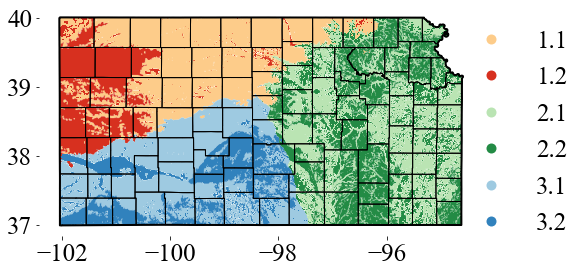

In [34]:
plt.figure(figsize=(8,10), constrained_layout=True) 
ax = plt.axes(projection=ccrs.PlateCarree())
ax = plt.axes() #
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams["font.size"] = 25
 
#plt.title('Kansas Agro-Climatic Zones w/ PAWC, Depth, Organic Matter', fontsize=16)

cmap = mpl.colors.ListedColormap(['#fdcc8a', '#d7301f',
                                   '#bae4b3', "#238b45",
                                    #   '#fef0d9',
                                   '#9ecae1', '#3182bd',
                                   ])#'#bdd7e7'

plot=df_map.plot(column='cluster', cmap=cmap, categorical=True,legend=True, ax=ax, legend_kwds=dict(bbox_to_anchor=(1.24,1), frameon=False))

ks_map.plot(ax=ax, color='none', edgecolor='black', linewidths =2)
map_county.plot(ax=ax, color='none', edgecolor='black', linewidths =1)

plt.box(False)

#plt.savefig('state_map.png', bbox_inches = 'tight', dpi=500)

plt.show()

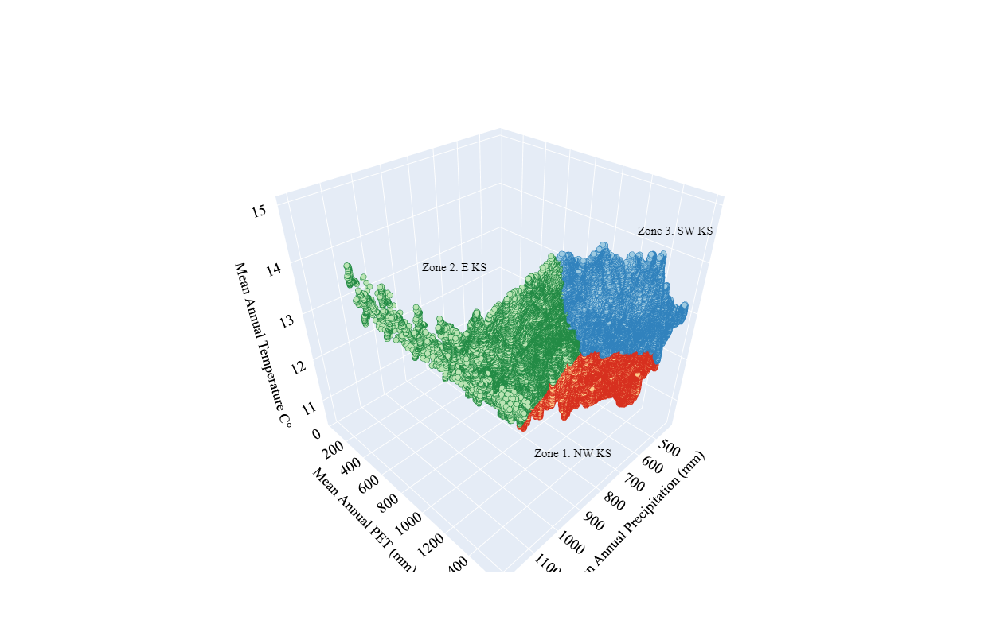

In [161]:
PLOT = go.Figure()

 
cmap = mpl.colors.ListedColormap([
                                   '#bae4b3', "#238b45",
                                   '#fdcc8a', '#d7301f', #   '#fef0d9',
                                   '#9ecae1', '#3182bd',
                                   ])#'#bdd7e7'
    
PLOT.add_trace(go.Scatter3d(x = df[df.macro == 1]['precip'],
                            y = df[df.macro == 1]['pet'],
                            z = df[df.macro == 1]['temp'],
                            mode = 'markers', marker_size = 4, marker_line_width = .0001,marker_color = '#fdcc8a',marker_line_color = '#d7301f', #marker_opacity = .5, 
                            ))#.update_traces(marker=dict(color='#bae4b3'))

 
PLOT.add_trace(go.Scatter3d(x = df[df.macro == 2]['precip'],
                            y = df[df.macro == 2]['pet'],
                            z = df[df.macro == 2]['temp'],
                            mode = 'markers', marker_size = 4, marker_line_width = .0001, marker_color = '#bae4b3',marker_line_color = "#238b45", #marker_opacity = .5, 
                            ))#.update_traces(marker=dict(color='#fdcc8a'))

PLOT.add_trace(go.Scatter3d(x = df[df.macro == 3]['precip'],
                            y = df[df.macro == 3]['pet'],
                            z = df[df.macro == 3]['temp'], 
                            mode = 'markers', marker_size = 4, marker_line_width =.000001,marker_line_color = '#3182bd', marker_color = '#9ecae1', #marker_opacity = .5, 
                            ))

PLOT.update_layout(
    scene=dict(
        annotations=[
        dict(
            showarrow=False,
            x=1185,
            y=998,
            z=15,
            text="Zone 2. E KS",
            xanchor="left",
            xshift=10,
           ), 
        dict(
            showarrow=False,
            x=850,
            y=1164,
            z=10.5,
            text="Zone 1. NW KS",
            xanchor="left",
           ),
        dict(
            showarrow=False,
            x=692,
            y=1485,
            z=15,
            text="Zone 3. SW KS",
            xanchor="left"),
            ]
    ),
    
)

PLOT.update_layout(width = 800, height = 800, autosize = True, showlegend = False,
               scene = dict(xaxis=dict(title = 'Mean Annual Precipitation (mm)', titlefont_color = 'black',),
                            yaxis=dict(title = 'Mean Annual PET (mm)', titlefont_color = 'black'),
                            zaxis=dict(title = f"Mean Annual Temperature C\N{DEGREE SIGN}", titlefont_color = 'black')),
               font = dict(family = "Times New Roman", color  = 'black', size = 15))
               
           

#PLOT.write_image('macro_cluster.png')
PLOT.write_html("macro_cluster.html")
PLOT

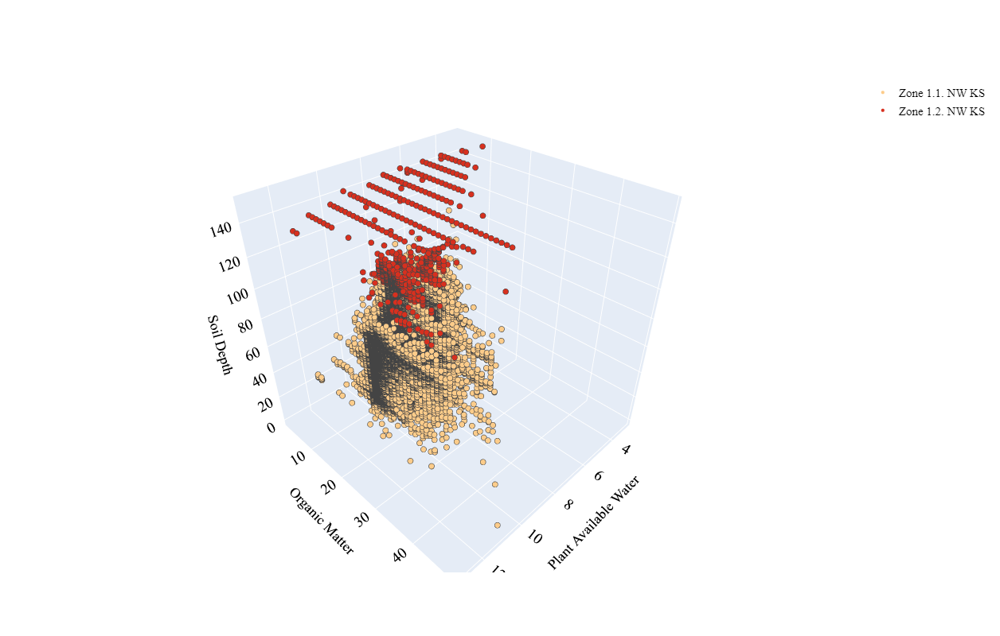

In [197]:
PLOT = go.Figure()

    
PLOT.add_trace(go.Scatter3d(x = df[df.cluster == 11]['paws_050'], 
                            y = df[df.cluster == 11]['om_kg_sq_m'],
                            z = df[df.cluster == 11]['depth_adj'],
                            mode = 'markers', marker_size = 4, marker_line_width = .0001, marker_color = '#fdcc8a',#marker_opacity = .5, 
                            name = 'Zone 1.1. NW KS'))#.update_traces(marker=dict(color='#bae4b3'))

PLOT.add_trace(go.Scatter3d(x = df[df.cluster == 12]['paws_050'], 
                            y = df[df.cluster == 12]['om_kg_sq_m'],
                            z = df[df.cluster == 12]['depth_adj'],
                            mode = 'markers', marker_size = 4, marker_line_width = .0001, marker_color = '#d7301f',#marker_opacity = .5, 
                            name = 'Zone 1.2. NW KS'))#.update_traces(marker=dict(color='#bae4b3'))



PLOT.update_layout(width = 800, height = 800, autosize = True, showlegend = True,
               scene = dict(xaxis=dict(title = 'Plant Available Water', titlefont_color = 'black',),
                            yaxis=dict(title = 'Organic Matter', titlefont_color = 'black'),
                            zaxis=dict(title = 'Soil Depth', titlefont_color = 'black')),
               font = dict(family = "Times New Roman", color  = 'black', size = 15)),
             #  font = dict(family = "Times New Roman", color  = 'black', size = 15))
              # marker = dict(line=dict(width=2,color='DarkSlateGrey'))

#PLOT.write_image('micro1_cluster.png')
PLOT.write_html("micro1_cluster.html")

PLOT

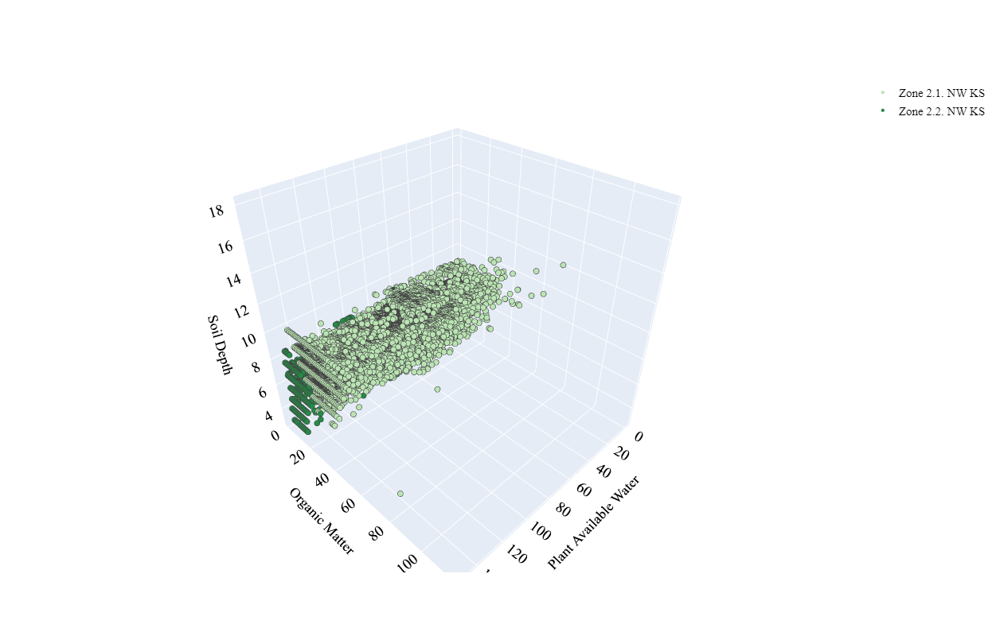

In [198]:
PLOT = go.Figure()


PLOT.add_trace(go.Scatter3d(z = df[df.cluster == 21]['paws_050'], 
                            y = df[df.cluster == 21]['om_kg_sq_m'],
                            x = df[df.cluster == 21]['depth_adj'],
                            mode = 'markers', marker_size = 4, marker_line_width = .0001, marker_color = '#bae4b3',#marker_opacity = .5, 
                            name = 'Zone 2.1. NW KS'))#.update_traces(marker=dict(color='#bae4b3'))

PLOT.add_trace(go.Scatter3d(z = df[df.cluster == 32]['paws_050'], 
                            y = df[df.cluster == 32]['om_kg_sq_m'],
                            x = df[df.cluster == 32]['depth_adj'],
                            mode = 'markers', marker_size = 4, marker_line_width = .0001, marker_color ="#238b45",#marker_opacity = .5, 
                            name = 'Zone 2.2. NW KS'))#.update_traces(marker=dict(color='#bae4b3'))


PLOT.update_layout(width = 800, height = 800, autosize = True, showlegend = True,
               scene = dict(xaxis=dict(title = 'Plant Available Water', titlefont_color = 'black',),
                            yaxis=dict(title = 'Organic Matter', titlefont_color = 'black'),
                            zaxis=dict(title = 'Soil Depth', titlefont_color = 'black')),
               font = dict(family = "Times New Roman", color  = 'black', size = 15)),
             #  font = dict(family = "Times New Roman", color  = 'black', size = 15))
              # marker = dict(line=dict(width=2,color='DarkSlateGrey'))

#PLOT.write_image('micro2_cluster.png')
PLOT.write_html("micro2_cluster.html")
PLOT

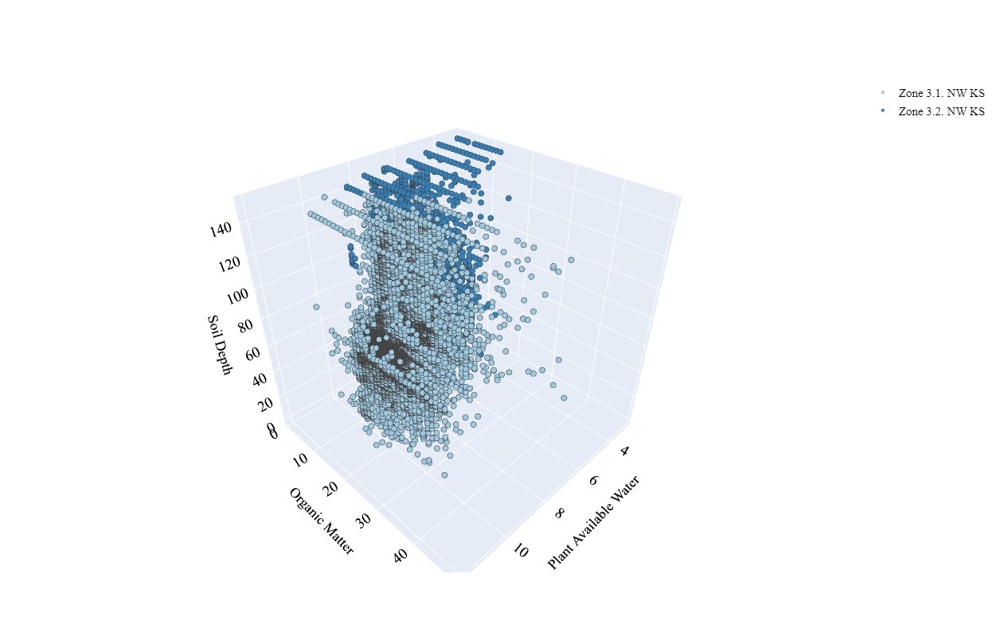

In [199]:
PLOT = go.Figure()

  
    
PLOT.add_trace(go.Scatter3d(x = df[df.cluster == 31]['paws_050'], 
                            y = df[df.cluster == 31]['om_kg_sq_m'],
                            z = df[df.cluster == 31]['depth_adj'],
                            mode = 'markers', marker_size = 4, marker_line_width = .0001, marker_color =   '#9ecae1',#marker_opacity = .5, 
                            name = 'Zone 3.1. NW KS'))#.update_traces(marker=dict(color='#bae4b3'))

PLOT.add_trace(go.Scatter3d(x = df[df.cluster == 32]['paws_050'], 
                            y = df[df.cluster == 32]['om_kg_sq_m'],
                            z = df[df.cluster == 32]['depth_adj'],
                            mode = 'markers', marker_size = 4, marker_line_width = .0001, marker_color = '#3182bd',#marker_opacity = .5, 
                            name = 'Zone 3.2. NW KS'))#.update_traces(marker=dict(color='#bae4b3'))




PLOT.update_layout(width = 800, height = 800, autosize = True, showlegend = True,
               scene = dict(xaxis=dict(title = 'Plant Available Water', titlefont_color = 'black',),
                            yaxis=dict(title = 'Organic Matter', titlefont_color = 'black'),
                            zaxis=dict(title = 'Soil Depth', titlefont_color = 'black')),
               font = dict(family = "Times New Roman", color  = 'black', size = 15)),
             #  font = dict(family = "Times New Roman", color  = 'black', size = 15))
              # marker = dict(line=dict(width=2,color='DarkSlateGrey'))

#PLOT.write_image('micro3_cluster.png')
PLOT.write_html("micro3_cluster.html")

PLOT